In [13]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots

In [2]:
wearable_data = pd.read_csv('dataset-har-PUC-Rio-ugulino-dataset.csv')

In [3]:
wearable_data.head()

,user,gender,age,how_tall_in_meters,weight,body_mass_index,x1,y1,z1,x2,y2,z2,x3,y3,z3,x4,y4,z4,class
0,debora,Woman,46,162,75,286,-3,92,-63,-23,18,-19,5,104,-92,-150,-103,-147,sitting
1,debora,Woman,46,162,75,286,-3,94,-64,-21,18,-18,-14,104,-90,-149,-104,-145,sitting
2,debora,Woman,46,162,75,286,-1,97,-61,-12,20,-15,-13,104,-90,-151,-104,-144,sitting
3,debora,Woman,46,162,75,286,-2,96,-57,-15,21,-16,-13,104,-89,-153,-103,-142,sitting
4,debora,Woman,46,162,75,286,-1,96,-61,-13,20,-15,-13,104,-89,-153,-104,-143,sitting


In [4]:
wearable_data.describe()

,age,how_tall_in_meters,weight,body_mass_index,x1,y1,z1,x2,y2,z2,x3,y3,z3,x4,y4,z4
count,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000,165633.000000
mean,38.265146,163.971220,70.819408,261.885216,-6.649327,88.293667,-93.164611,-87.827504,-52.065047,-175.055200,17.423515,104.517167,-93.881726,-167.641448,-92.625171,-159.650891
std,13.184091,5.282034,11.296527,29.957772,11.616238,23.895829,39.409423,169.435194,205.159763,192.816615,52.635388,54.155843,45.389646,38.311342,19.968610,13.221036
min,28.000000,158.000000,55.000000,220.000000,-306.000000,-271.000000,-603.000000,-494.000000,-517.000000,-617.000000,-499.000000,-506.000000,-613.000000,-702.000000,-526.000000,-537.000000
25%,28.000000,158.000000,55.000000,220.000000,-12.000000,78.000000,-120.000000,-35.000000,-29.000000,-141.000000,9.000000,95.000000,-103.000000,-190.000000,-103.000000,-167.000000
50%,31.000000,162.000000,75.000000,284.000000,-6.000000,94.000000,-98.000000,-9.000000,27.000000,-118.000000,22.000000,107.000000,-90.000000,-168.000000,-91.000000,-160.000000
75%,46.000000,171.000000,83.000000,286.000000,0.000000,101.000000,-64.000000,4.000000,86.000000,-29.000000,34.000000,120.000000,-80.000000,-153.000000,-80.000000,-153.000000
max,75.000000,171.000000,83.000000,286.000000,509.000000,533.000000,411.000000,473.000000,295.000000,122.000000,507.000000,517.000000,410.000000,-13.000000,86.000000,-43.000000


In [5]:
wearable_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 165633 entries, 0 to 165632
Data columns (total 19 columns):
 #   Column              Non-Null Count   Dtype 
---  ------              --------------   ----- 
 0   user                165633 non-null  object
 1   gender              165633 non-null  object
 2   age                 165633 non-null  int64 
 3   how_tall_in_meters  165633 non-null  int64 
 4   weight              165633 non-null  int64 
 5   body_mass_index     165633 non-null  int64 
 6   x1                  165633 non-null  int64 
 7   y1                  165633 non-null  int64 
 8   z1                  165633 non-null  int64 
 9   x2                  165633 non-null  int64 
 10  y2                  165633 non-null  int64 
 11  z2                  165633 non-null  int64 
 12  x3                  165633 non-null  int64 
 13  y3                  165633 non-null  int64 
 14  z3                  165633 non-null  int64 
 15  x4                  165633 non-null  int64 
 16  y4

In [17]:
# Check for missing values
print(wearable_data.isnull().sum())

user                  0
gender                0
age                   0
how_tall_in_meters    0
weight                0
body_mass_index       0
x1                    0
y1                    0
z1                    0
x2                    0
y2                    0
z2                    0
x3                    0
y3                    0
z3                    0
x4                    0
y4                    0
z4                    0
class                 0
dtype: int64


No missing values in the data

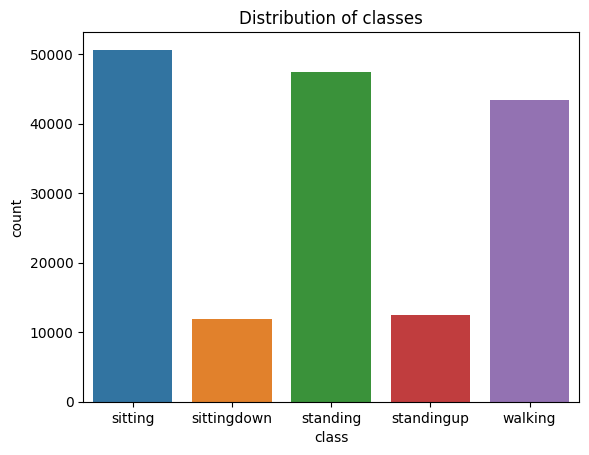

In [18]:
# Visualize the distribution of target variable
sns.countplot(data=wearable_data, x='class')
plt.title('Distribution of classes')
plt.show()


The target variable (class) is imbalanced, with sitting, standing and walking being the most frequent activities.

In [19]:
wearable_data['gender'] = pd.Categorical(wearable_data.gender)
wearable_data['class'] = pd.Categorical(wearable_data['class'])

In [20]:
wearable_data['age'].unique()

array([46, 28, 31, 75])

In [21]:
wearable_data.head()

,user,gender,age,how_tall_in_meters,weight,body_mass_index,x1,y1,z1,x2,y2,z2,x3,y3,z3,x4,y4,z4,class
0,debora,Woman,46,162,75,286,-3,92,-63,-23,18,-19,5,104,-92,-150,-103,-147,sitting
1,debora,Woman,46,162,75,286,-3,94,-64,-21,18,-18,-14,104,-90,-149,-104,-145,sitting
2,debora,Woman,46,162,75,286,-1,97,-61,-12,20,-15,-13,104,-90,-151,-104,-144,sitting
3,debora,Woman,46,162,75,286,-2,96,-57,-15,21,-16,-13,104,-89,-153,-103,-142,sitting
4,debora,Woman,46,162,75,286,-1,96,-61,-13,20,-15,-13,104,-89,-153,-104,-143,sitting


In [22]:
print(f"Unique age - {wearable_data['age'].unique()}")
print(f"Unique height - {wearable_data['how_tall_in_meters'].unique()}")
print(f"Unique weight - {wearable_data['weight'].unique()}")
print(f"Unique BMI - {wearable_data['body_mass_index'].unique()}")
print(f"Unique users - {wearable_data['user'].unique()}")
print(f"Unique class - {wearable_data['class'].unique()}")

Unique age - [46 28 31 75]
Unique height - [162 158 171 167]
Unique weight - [75 55 83 67]
Unique BMI - [286 220 284 240]
Unique users - ['debora' 'katia' 'wallace' 'jose_carlos']
Unique class - ['sitting', 'sittingdown', 'standing', 'standingup', 'walking']
Categories (5, object): ['sitting', 'sittingdown', 'standing', 'standingup', 'walking']


In [24]:
fig = px.parallel_categories(wearable_data)
fig.show()
fig.write_html("categories.html")

In [25]:
fig = px.sunburst(wearable_data, path=['class', 'user'], values='age',
                  color='age', hover_data=['age'],
                  color_continuous_scale='RdBu',
                  color_continuous_midpoint=np.average(wearable_data['age']))
fig.show()
fig.write_html("sunburst.html")